# Show Recovered Segmentations

To demonstrate the end-to-end proces

## Imports

In [2]:
from PIL import Image
from IPython.display import display
import os
from ultralytics import YOLO
import torch
import numpy as np
import albumentations as A
from transformers import MaskFormerImageProcessor
from transformers import Mask2FormerForUniversalSegmentation

/home/kindersc/.local/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


## Show example image

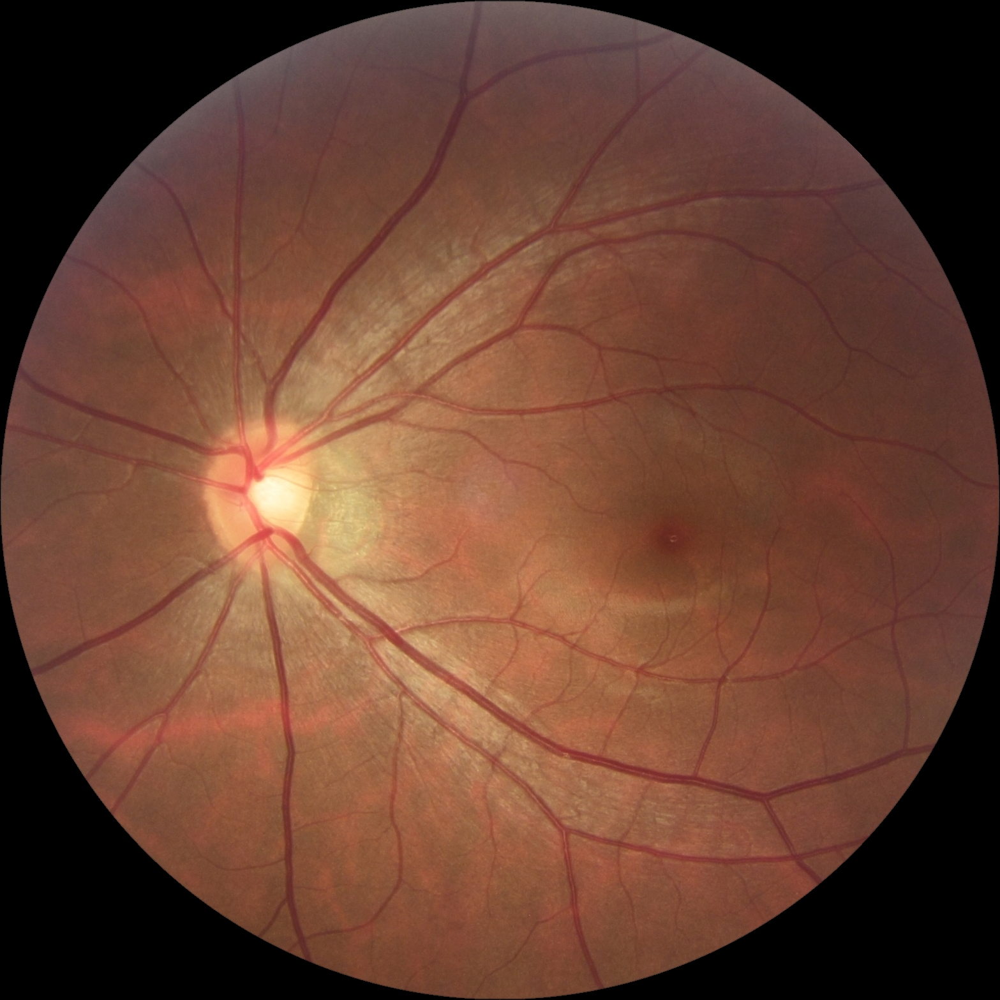

In [4]:


# Replace 'path/to/your/image.jpg' with the actual path to your image file
img_file_path = '/home/kindersc/Documents/datasets/glaucoma_datasets/yolo/working_structure/wideangle/images/test/refuge_T0273.png'

# Open the image using Pillow
image = Image.open(img_file_path)

# Display the image
display(image)


In [5]:
image.width

1567

In [6]:
image.height

1567

## Define functions

In [7]:
def cut_xy(orig_x, orig_y, orig_w, orig_h, cut_diff):
    orig_x += cut_diff
    orig_y += cut_diff
    orig_w -= cut_diff * 2
    orig_h -= cut_diff * 2
    return orig_x, orig_y, orig_w, orig_h

In [8]:
def yolo_inference_function(model, img_file_path, threshold=1e-6, output_img_size=512, padding=25):
    image = Image.open(img_file_path)
    orig_height = image.height
    orig_width = image.width
    orig_wh = [orig_width, orig_height]
    # print(f'orig height: {orig_height}, orig width: {orig_width}')
    res = model([image])

    best_coords = None
    res_i = res[0]
    # Sometimes, it will make no predictions (no objects i.e. all white image)
    # Sometimes makes more than 1, which isn't a big problem is first (best) one
    # is good...
    # print(res)
    if res_i.boxes.conf.numel() > 0:
        curr_conf = res_i.boxes.conf[0].item()
        # check it is above threshold
        if curr_conf > threshold:
            best_coords = res_i.boxes.xyxy.detach().cpu().numpy()[0]
    # if there was one, get the best one
    if best_coords is not None:
        x = best_coords[0]
        y = best_coords[1]
        w = best_coords[2] - best_coords[0]
        h = best_coords[3] - best_coords[1]
        print('x: ', x)
        print('y: ', y)
        print('w: ', w)
        print('h: ', h)
        print("best coords: ", best_coords)

        # Rescale the original image such that the disc boundary is square, and
        # sized output_img_size - padding * 2
        # if the entire image is going to be 512,512, then the disc extent
        # should be 512 - padding*2
        scale_factor_height = (output_img_size - (padding * 2)) / h
        scale_factor_width = (output_img_size - (padding * 2)) / w
        rescaled_height = int(image.height * scale_factor_height)
        rescaled_width = int(image.width * scale_factor_width)

        recovered_wh = [rescaled_width, rescaled_height]


        image_resized = image.resize((rescaled_width, rescaled_height))

        image_array_resized = np.array(image_resized)

        new_x = int((x * scale_factor_width) - padding)
        new_y = int((y * scale_factor_height) - padding)
        new_w = output_img_size
        new_h = output_img_size

        # Ensure the coordinates are within the image boundaries
        if new_x < 0:
            print(f"hit: {image_resized.width}, {new_w}, {new_x}, {img_file_path}")
            # find amount it is being cut off by, if it is less than y
            if new_x < new_y:
                cut_diff = abs(new_x)
            else:
                cut_diff = abs(new_y)
            new_x, new_y, new_w, new_h = cut_xy(new_x, new_y, new_w, new_h, cut_diff)
        elif new_y < 0:
            print(f"hit: {image_resized.height}, {new_h}, {new_y}, {img_file_path}")
            # find amount it is being cut off by, if it is less than y
            cut_diff = abs(new_y)
            new_x, new_y, new_w, new_h = cut_xy(new_x, new_y, new_w, new_h, cut_diff)
        elif image_resized.width < new_x + new_w:
            print(f"hit: {image_resized.width}, {new_w}, {new_x}, {img_file_path}")
            cut_width = (new_x + new_w) - image_resized.width
            cut_height = (new_y + new_h) - image_resized.height
            if (cut_width < cut_height):
                cut_diff = cut_height
            else:
                cut_diff = cut_width
            new_x, new_y, new_w, new_h = cut_xy(new_x, new_y, new_w, new_h, cut_diff)
        elif image_resized.height - new_h < new_y:
            print(f"hit: {image_resized.height}, {new_h}, {new_y}, {img_file_path}")
            cut_diff = (new_y + new_h) - image_resized.height
            new_x, new_y, new_w, new_h = cut_xy(new_x, new_y, new_w, new_h, cut_diff)

        # Crop the images
        cropped_image_arr = image_array_resized[new_y:new_y+new_h, new_x:new_x+new_w]

        best_coords_x0 = new_x
        best_coords_x1 = new_x+new_w
        best_coords_y0 = new_y
        best_coords_y1 = new_y+new_h
        recovered_xyxy = [best_coords_x0, best_coords_y0, best_coords_x1, best_coords_y1]

        # Convert back to PIL Image
        cropped_image = Image.fromarray(cropped_image_arr)

        recovered_resize = [512,512]

        if cropped_image.width != 512 or cropped_image.height != 512:
            print("must have had a cut off image because on edge")
            print(f"orig width heights: {cropped_image.width}, {cropped_image.height}")
            recovered_resize = [cropped_image.width, cropped_image.height]
            cropped_image = cropped_image.resize((output_img_size, output_img_size))

        # Image should be good now!
            
        return cropped_image, orig_wh, recovered_wh, recovered_xyxy, recovered_resize

    else:
        print('=!=!=============No best coords for: %s=============!=!=', img_file_path)


## Load YOLO model

and get outputs from infer function

In [9]:
# Define model
yolo_model = YOLO('best_full_fundus.pt').to(device)

### 1. Infer with YOLO model

In [10]:
cropped_img, orig_wh, recovered_wh, recovered_xyxy, recovered_resize = yolo_inference_function(yolo_model, img_file_path)


0: 640x640 1 opticnervehead, 14.2ms
Speed: 3.2ms preprocess, 14.2ms inference, 184.4ms postprocess per image at shape (1, 3, 640, 640)
x:  319.49106
y:  653.1323
w:  173.4585
h:  229.97888
best coords:  [     319.49      653.13      492.95      883.11]


In [11]:
print(orig_wh)
print(recovered_wh)
print(recovered_xyxy)
print(recovered_resize)

[1567, 1567]
[4173, 3147]
[825, 1287, 1337, 1799]
[512, 512]


### 2. Resize the global image

In [12]:
recovered_orig_image = image.resize((int(recovered_wh[0]),int(recovered_wh[1])))

In [13]:
print(recovered_xyxy[2] - recovered_xyxy[0])
print(recovered_xyxy[3] - recovered_xyxy[1])

512
512


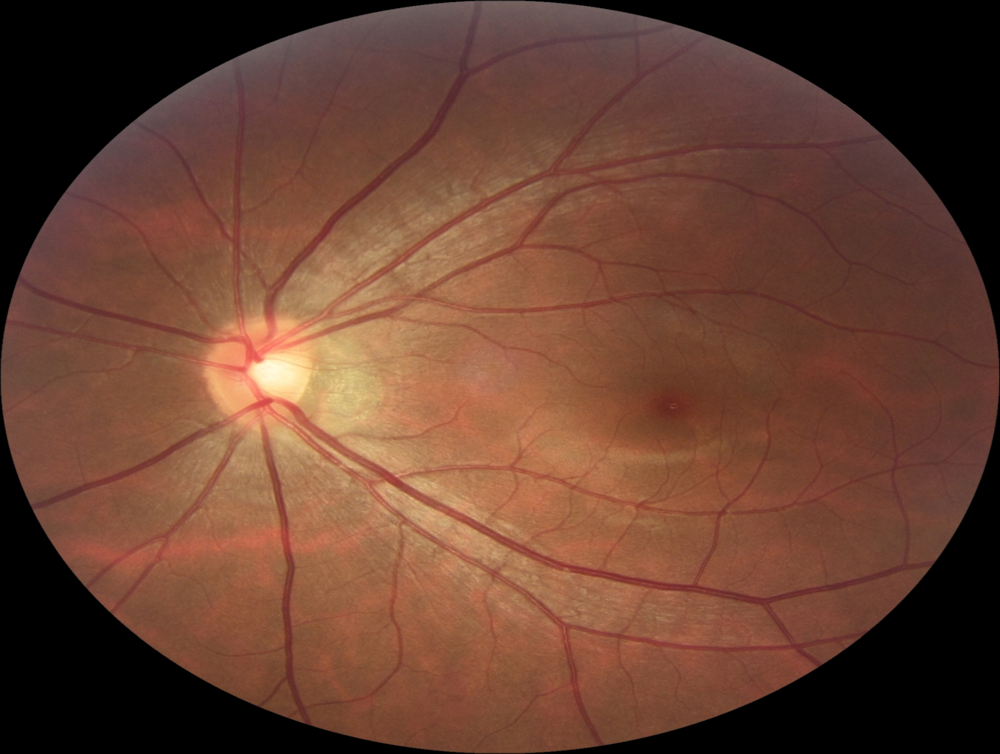

In [14]:
display(recovered_orig_image)

#### Confirm the BBox is still in the right spot

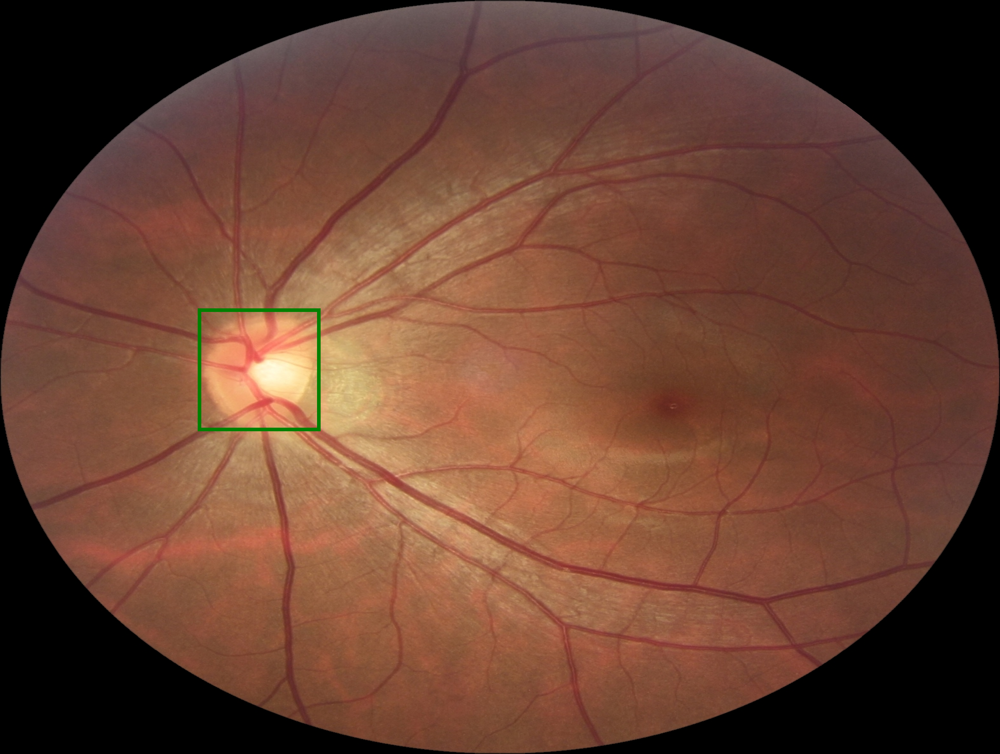

In [15]:
from PIL import Image, ImageDraw

def overlay_red_box(img, x0, y0, x1, y1, width=15):
    
    # Create Drawing Object
    draw = ImageDraw.Draw(img)
    
    # Draw the red box
    draw.rectangle([x0, y0, x1, y1], outline="green", width=width)
    
    # Save or display the image
    display(img)

overlay_red_box(recovered_orig_image, recovered_xyxy[0], recovered_xyxy[1], recovered_xyxy[2], recovered_xyxy[3])

In [16]:
recovered_xyxy

[825, 1287, 1337, 1799]

In [17]:
image.size

(1567, 1567)

#### And that BBox prediction on original was correct

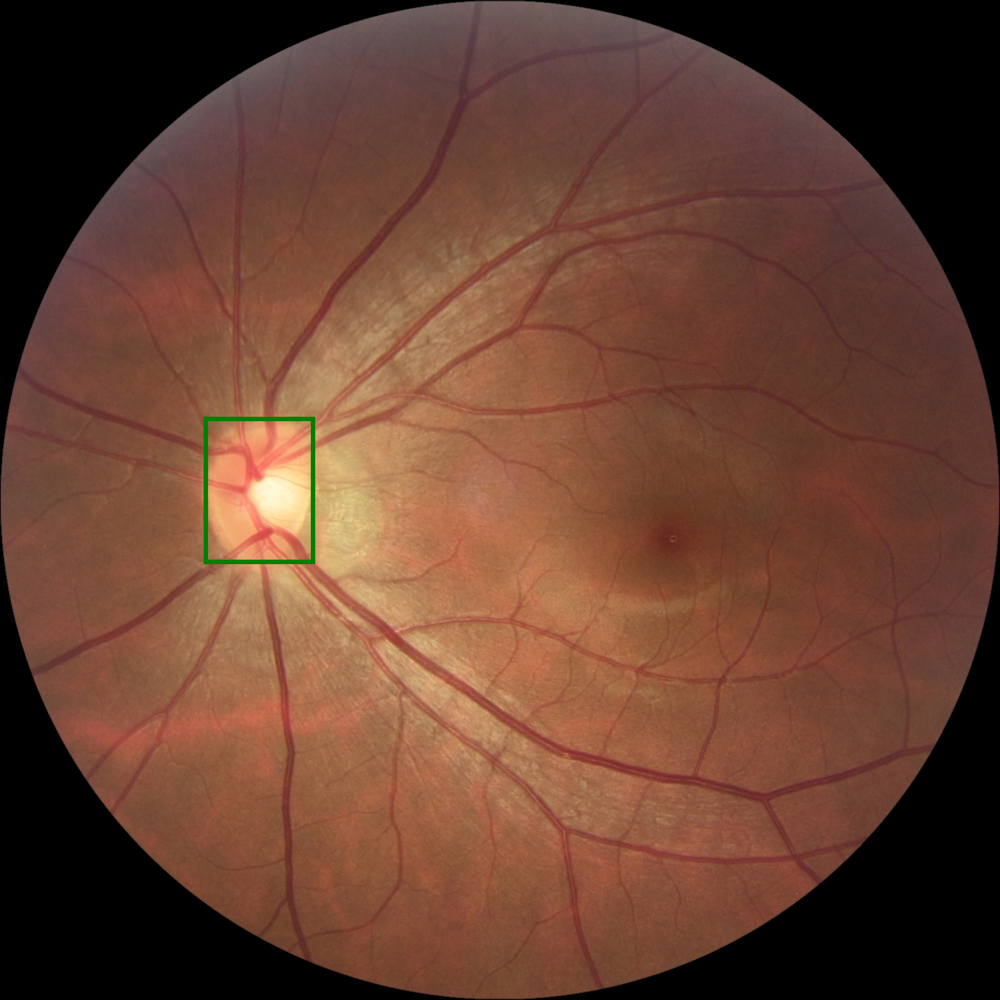

In [18]:
overlay_red_box(image, 319, 653, 493, 883, width=7)

### 3. Get cropped image, with padding

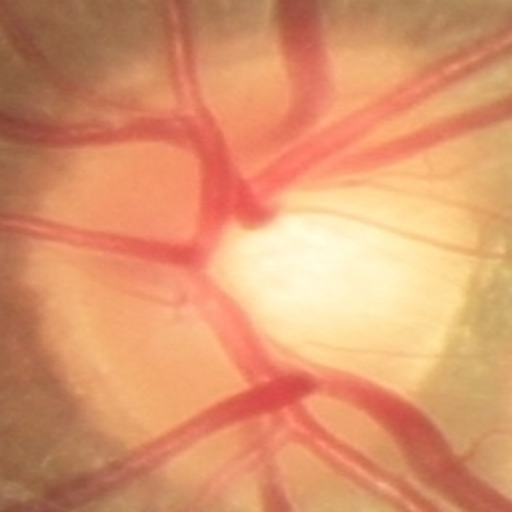

In [19]:
display(cropped_img)

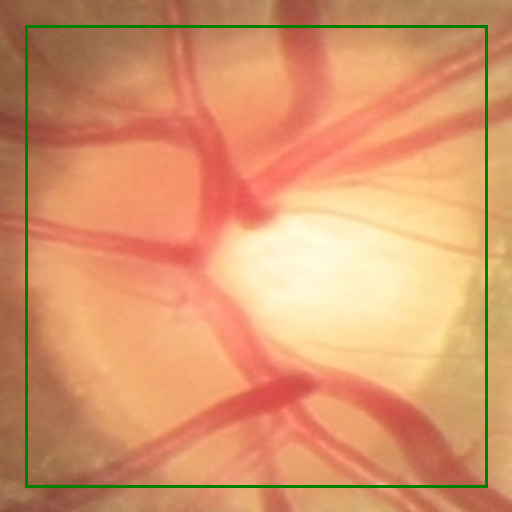

In [20]:
overlay_red_box(cropped_img, 25, 25, 487, 487, width=3)

In [21]:
cropped_img_np = np.array(cropped_img)[:,:,0:3]

In [22]:
cropped_img_np.shape

(512, 512, 3)

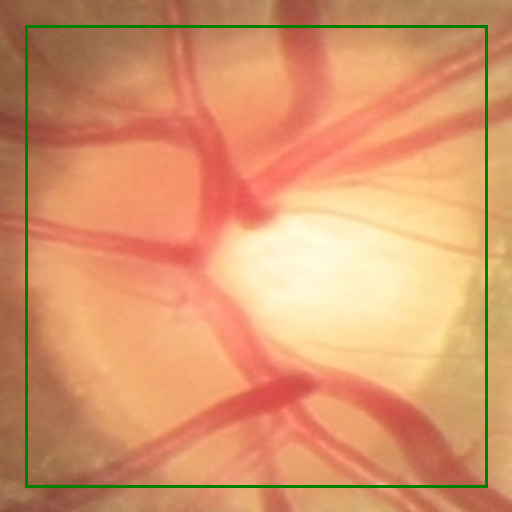

In [23]:
display(Image.fromarray(cropped_img_np))

#### 4. Segment

##### Get segmentation vars

In [24]:
ADE_MEAN = np.array([0.768, 0.476, 0.290])
ADE_STD = np.array([0.220, 0.198, 0.166])
transform = A.Compose([
    A.Normalize(mean=ADE_MEAN, std=ADE_STD)
])
palette = [[255,0,0], [0,255,0], [0,0,255]]
model_path = 'mask2former/model.pt'
id2label = {
    0: "unlabeled",
    1: "bg",
    2: "disc",
    3: "cup"
}
img_pil = Image.fromarray(cropped_img_np)

In [26]:
# Replace the head of the pre-trained model
model = Mask2FormerForUniversalSegmentation.from_pretrained("facebook/mask2former-swin-large-cityscapes-semantic",
                                                            id2label=id2label,
                                                            ignore_mismatched_sizes=True).to(device)

Some weights of Mask2FormerForUniversalSegmentation were not initialized from the model checkpoint at facebook/mask2former-swin-large-cityscapes-semantic and are newly initialized because the shapes did not match:
- class_predictor.bias: found shape torch.Size([20]) in the checkpoint and torch.Size([5]) in the model instantiated
- class_predictor.weight: found shape torch.Size([20, 256]) in the checkpoint and torch.Size([5, 256]) in the model instantiated
- criterion.empty_weight: found shape torch.Size([20]) in the checkpoint and torch.Size([5]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [27]:

# Load the state dictionary
model.load_state_dict(torch.load(model_path, map_location=device))
model.eval()

# Create a preprocessor
preprocessor = MaskFormerImageProcessor(ignore_index=0, reduce_labels=False, do_resize=False, do_rescale=False, do_normalize=False)

/home/kindersc/.local/lib/python3.10/site-packages/transformers/models/maskformer/image_processing_maskformer.py:428: FutureWarning: The `reduce_labels` argument is deprecated and will be removed in v4.27. Please use `do_reduce_labels` instead.
  warnings.warn(


In [66]:
def seg_inference_function(model, img_pil, transform, preprocessor, palette, device):
    # print("running inference")

    width, height = img_pil.size
    transformed_image = transform(image=np.array(img_pil))['image'].transpose(2,0,1)

    # prepare image for the model
    inputs = preprocessor(images=transformed_image, return_tensors="pt").to(device)

    # forward pass
    with torch.no_grad():
        outputs = model(**inputs)

    target_sizes = [(height, width)]
    # predict segmentation maps
    predicted_segmentation_maps = preprocessor.post_process_semantic_segmentation(outputs,
                                                                                target_sizes=target_sizes)
    
    # Val
    pred_segmentation_map = predicted_segmentation_maps[0].cpu().numpy()

    color_segmentation_map = np.zeros((pred_segmentation_map.shape[0], pred_segmentation_map.shape[1], 3), dtype=np.uint8) # height, width, 3
    for label, color in enumerate(palette):
        color_segmentation_map[pred_segmentation_map - 1 == label, :] = color
    # Convert to BGR
    pred_color_seg = color_segmentation_map[..., ::1]
    gray_image = np.zeros_like(pred_color_seg[:,:,0])
    gray_image[pred_color_seg[:,:,0] == 255] = 0
    gray_image[pred_color_seg[:,:,1] == 255] = 127
    gray_image[pred_color_seg[:,:,2] == 255] = 255
    return gray_image

##### Perform inference call

In [67]:
seg_output = seg_inference_function(model, img_pil, transform, preprocessor, palette, device)

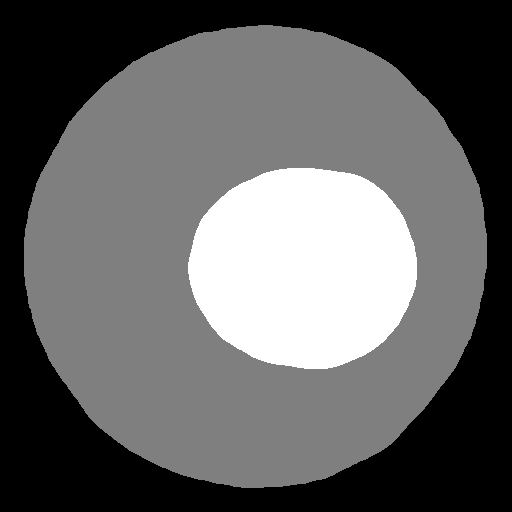

In [68]:
Image.fromarray(seg_output)

In [69]:
# blended = 0.1*seg_output + 0.9*cropped_img_np
# blended_array = np.clip(blended, 0, 255).astype(np.uint8)

In [70]:
# display(Image.fromarray(blended_array))

In [71]:
# Map the original colors to the desired grayscale values

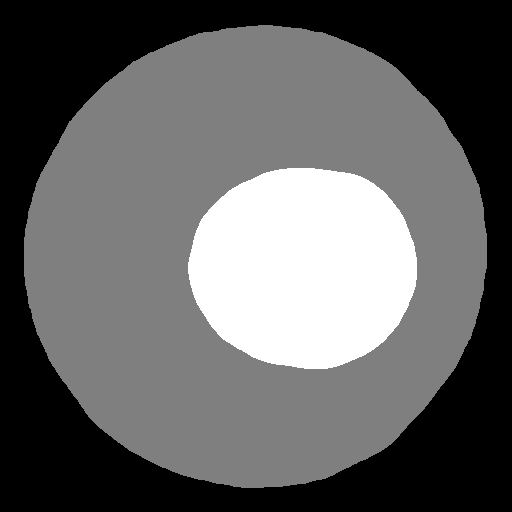

In [72]:
display(Image.fromarray(seg_output))

In [73]:
# Create a color mapping array
color_map = np.zeros((256, 3), dtype=np.uint8)
color_map[0] = [255, 0, 0]     # Red
color_map[127] = [0, 255, 0]    # Green
color_map[255] = [0, 0, 255]    # Blue

# Use the grayscale image as an index to the color map
seg_color_output = color_map[seg_output]


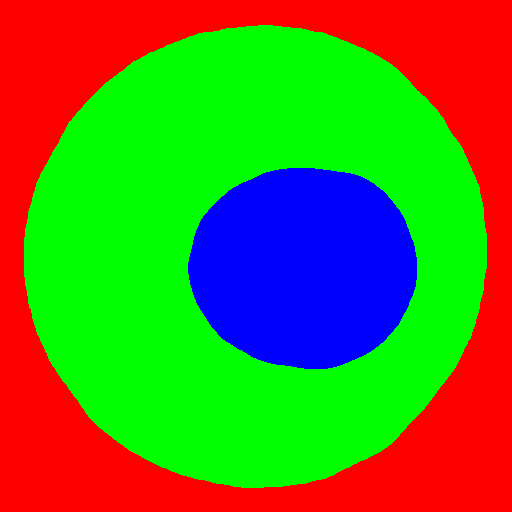

In [74]:
display(Image.fromarray(seg_color_output))

In [75]:
from segmentation_train_and_inference.utils.infer_utils import get_max_vertical_diameter, get_contours

In [76]:
disc_contours = get_contours(seg_color_output, channel_idx=1)
cup_contours = get_contours(seg_color_output, channel_idx=2)

In [77]:
disc_diameter = get_max_vertical_diameter(disc_contours, seg_map=seg_color_output, line_thickness=3)
cup_diameter = get_max_vertical_diameter(cup_contours, seg_map=seg_color_output, line_thickness=3)

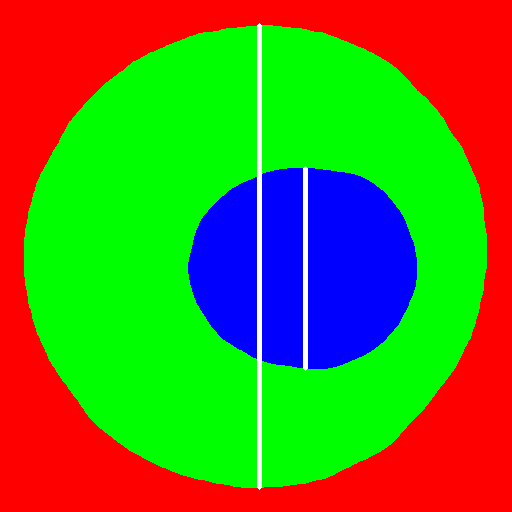

In [78]:
display(Image.fromarray(seg_color_output))

In [79]:
seg_color_output[(seg_color_output == [255, 255, 255]).all(axis=-1)] = [254, 0, 0]

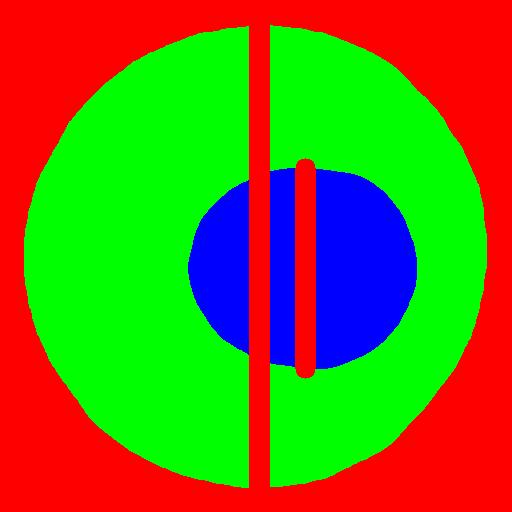

In [42]:
display(Image.fromarray(seg_color_output))

In [43]:
seg_color_output[(seg_color_output == [0, 0, 255]).all(axis=-1)] = [255, 255, 255]

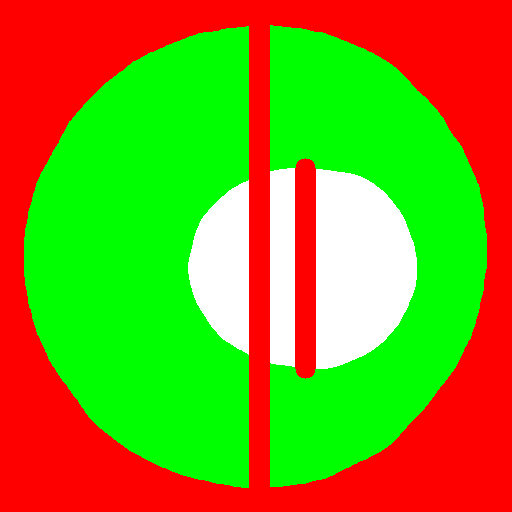

In [44]:
display(Image.fromarray(seg_color_output))

In [45]:
seg_color_output[(seg_color_output == [0, 255, 0]).all(axis=-1)] = [127, 127, 127]

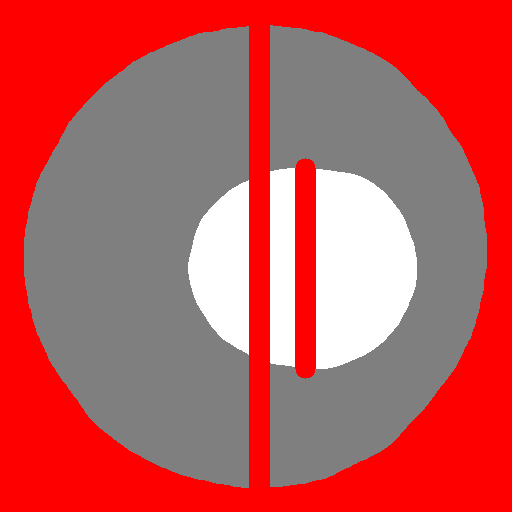

In [46]:
display(Image.fromarray(seg_color_output))

In [47]:
seg_color_output[(seg_color_output == [255, 0, 0]).all(axis=-1)] = [0, 0, 0]

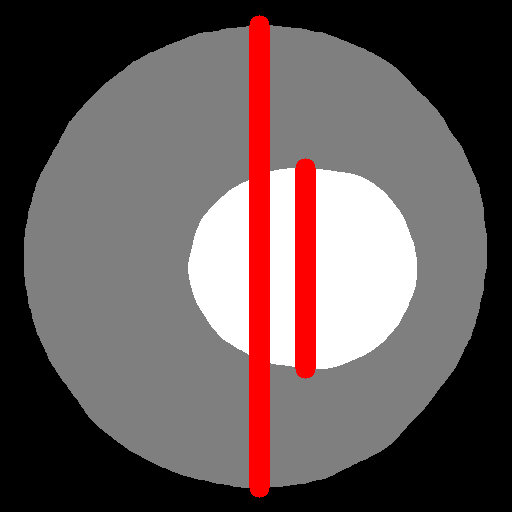

In [48]:
display(Image.fromarray(seg_color_output))

In [49]:
recovered_resize

[512, 512]

#### 5. Place back onto original resized fundus image

In [50]:
# Create a NumPy array filled with zeros
recovered_seg = np.zeros((int(recovered_wh[1]), int(recovered_wh[0]), 3), dtype=np.uint8)

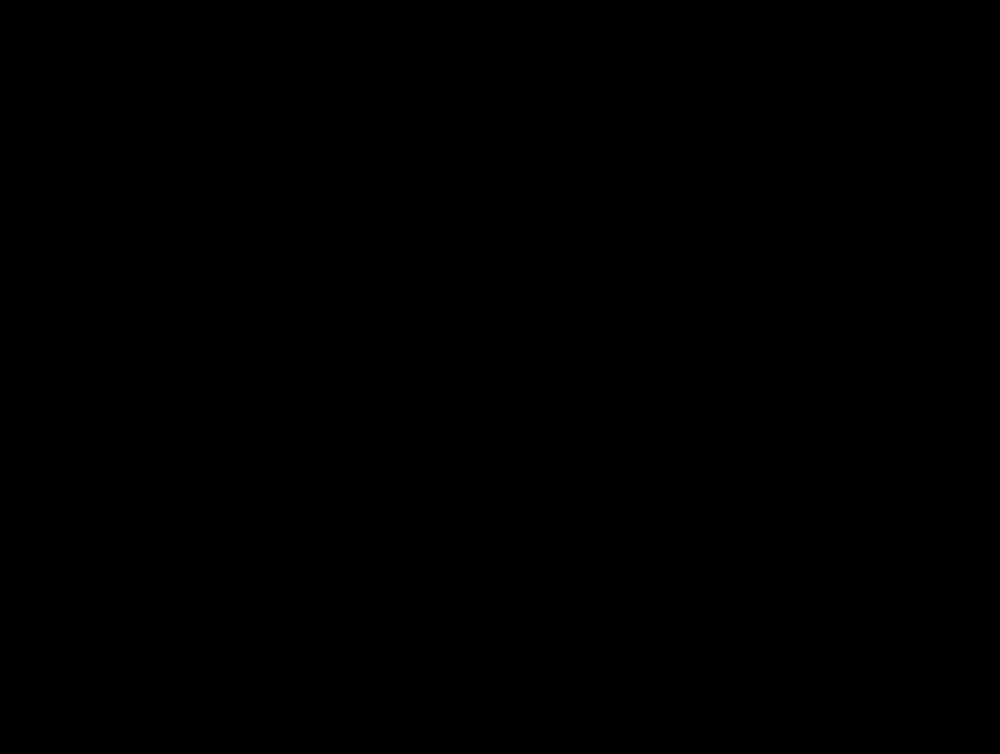

In [51]:
display(Image.fromarray(recovered_seg))

In [52]:
print(recovered_xyxy)

[825, 1287, 1337, 1799]


In [53]:
print(recovered_xyxy[2] - recovered_xyxy[0])
print(recovered_xyxy[3] - recovered_xyxy[1])
recovered_x0 = int(recovered_xyxy[0])
recovered_x1 = int(recovered_xyxy[2])
recovered_y0 = int(recovered_xyxy[1])
recovered_y1 = int(recovered_xyxy[3])

512
512


In [54]:
seg_output = Image.fromarray(seg_color_output).resize((recovered_resize[0], recovered_resize[1]))
seg_output = np.array(seg_output)

In [55]:
seg_output.shape

(512, 512, 3)

In [56]:
recovered_seg[recovered_y0:recovered_y1, recovered_x0:recovered_x1, :] = seg_output

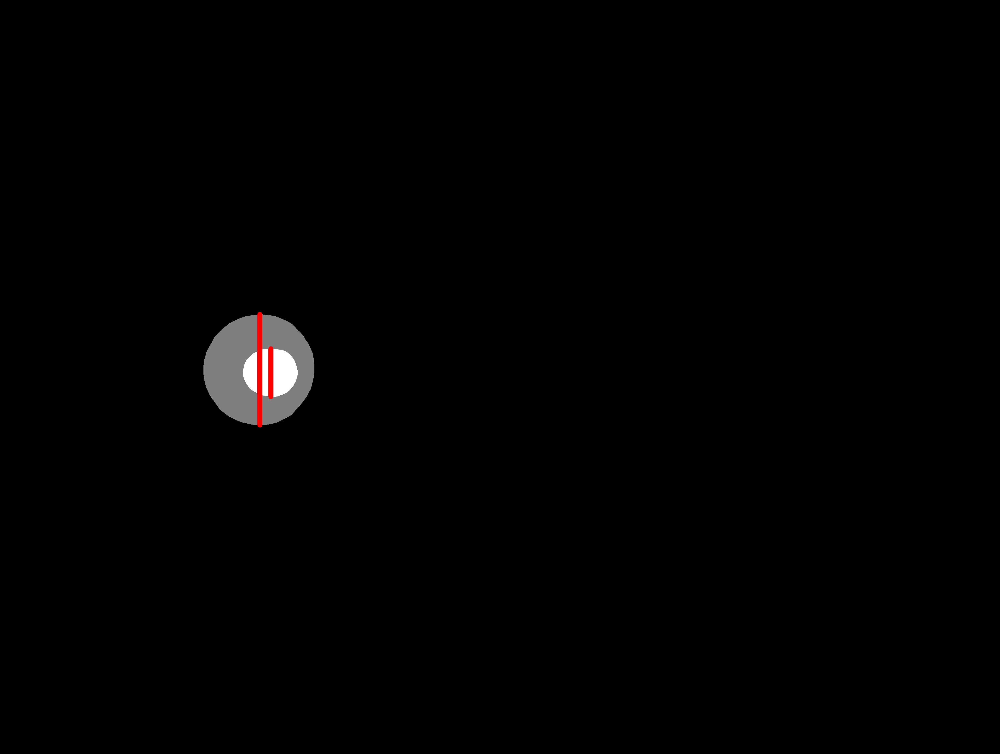

In [57]:
display(Image.fromarray(recovered_seg))

In [58]:
# gray_image_3d = np.expand_dims(recovered_seg, axis=-1)
# Repeat the single channel along the third axis
# rgb_image = np.repeat(gray_image_3d, 3, axis=-1)
rgb_image = recovered_seg


In [59]:
blended = 0.5*rgb_image + 0.5*np.array(recovered_orig_image)[:,:,0:3]
blended_array = np.clip(blended, 0, 255).astype(np.uint8)

In [60]:
blended_array.shape

(3147, 4173, 3)

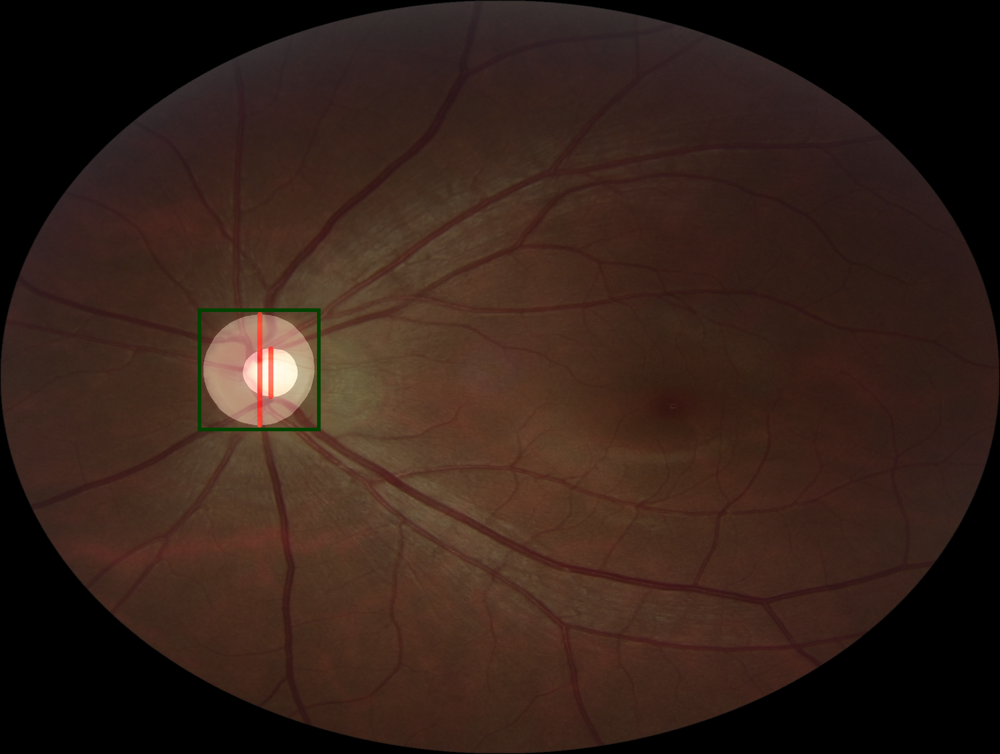

In [61]:
display(Image.fromarray(blended_array))

In [62]:
blended_array_pil = Image.fromarray(blended_array)

##### 6. Restore back to original image

In [63]:
blended_array_pil = blended_array_pil.resize((orig_wh[0], orig_wh[1]))

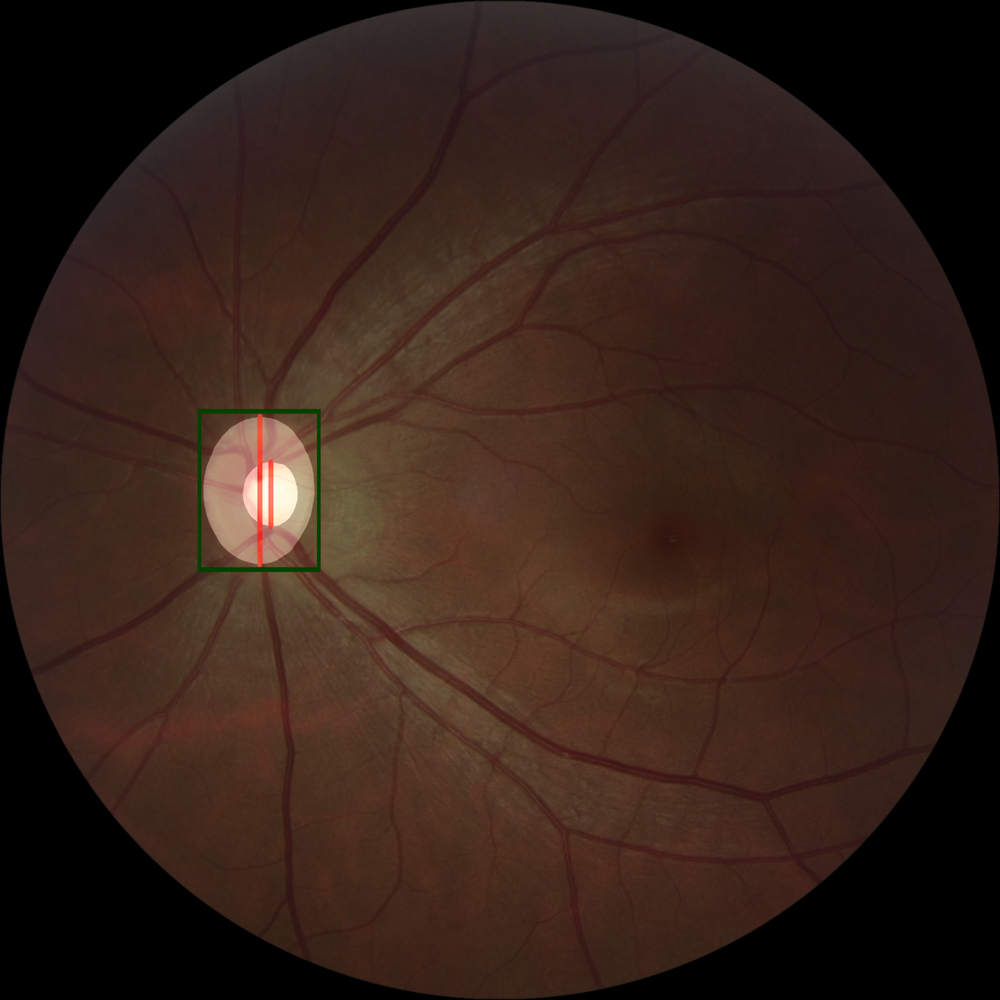

In [64]:
display(blended_array_pil)